# Stable Diffusion Benchmark

In [1]:
!nvidia-smi

Sun Dec 18 06:12:53 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ...  On   | 00000000:01:00.0 Off |                  N/A |
|  0%   34C    P8     9W / 250W |     84MiB / 11264MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA GeForce ...  On   | 00000000:02:00.0 Off |                  N/A |
|  0%   

In [2]:
import torch
torch.cuda.set_device(1)

/home/seb.derhy/anaconda3/envs/sdv2/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# !pip install -Uq diffusers transformers fastcore

## Using Stable Diffusion

To run Stable Diffusion on your computer you have to accept the model license. It's an open CreativeML OpenRail-M license that claims no rights on the outputs you generate and prohibits you from deliberately producing illegal or harmful content. The [model card](https://huggingface.co/CompVis/stable-diffusion-v1-4) provides more details. If you do accept the license, you need to be a registered user in 🤗 Hugging Face Hub and use an access token for the code to work. You have two options to provide your access token:

* Use the `huggingface-cli login` command-line tool in your terminal and paste your token when prompted. It will be saved in a file in your computer.
* Or use `notebook_login()` in a notebook, which does the same thing.

In [4]:
from PIL import Image
from fastcore.all import concat
import torch, logging
from pathlib import Path
from huggingface_hub import notebook_login
from diffusers import StableDiffusionPipeline
from PIL import Image
import matplotlib.pyplot as plt
logging.disable(logging.WARNING)

if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

In [5]:
from tqdm.auto import tqdm

In [6]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

# Test pipeline

In [7]:
seed = 42

In [8]:
prompts = [
    'An astronaut riding a horse',
    'A handsome businesssman working',
    'A hand shake',
    'A woman eating an ice cream'
]
# prompts = [
#     'An astronaut riding a horse, realistic, detailed',
#     'A handsome businesssman working, realistic, detailed',
#     'A hand shake between 2 important people, realistic, detailed',
#     'A model eating an ice cream, realistic, detailed'
# ]
## From: https://mpost.io/best-100-stable-diffusion-prompts-the-most-beautiful-ai-text-to-image-prompts/ 
prompts = [
    'portrait photo of an astronaut riding a horse',
    'portrait photo of a handsome businesssman',
    'portrait photo of a asia old warrior chief, tribal panther make up, blue on red, side profile, looking away, serious eyes, 50mm portrait photography, hard rim lighting photography',
    'portrait photo headshot by mucha, sharp focus, elegant, render, octane, detailed, award winning photography, masterpiece, rim lit'
]

In [9]:
guidance_scale = 7.5
num_inference_steps = 50

device = torch.device("cuda")
num_images_per_prompt = 1

In [10]:
from diffusers import StableDiffusionPipeline, EulerDiscreteScheduler
import torch

model_id = "stabilityai/stable-diffusion-2-base"

# Use the Euler scheduler here instead
scheduler = EulerDiscreteScheduler.from_pretrained(model_id, subfolder="scheduler")
pipe = StableDiffusionPipeline.from_pretrained(model_id, scheduler=scheduler, revision="fp16", torch_dtype=torch.float16)
pipe = pipe.to("cuda")

Fetching 12 files: 100%|██████████| 12/12 [00:00<00:00, 16215.09it/s]


In [11]:
torch.manual_seed(seed)
images = pipe(prompts, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt).images

100%|██████████| 50/50 [00:55<00:00,  1.11s/it]


In [12]:
len(images)

4

In [13]:
ref_images = images.copy()

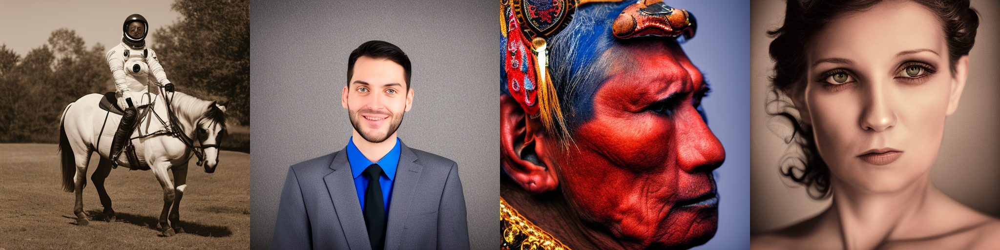

In [14]:
image_grid(ref_images, rows=num_images_per_prompt, cols=len(prompts))

# Reproduce inference loop 

In [15]:
def regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    return latents

In [16]:
@torch.no_grad()
def my_sd_sampling(prompt=prompts, device=device, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt, 
             custom_update=None):
    
    # 0. Default height and width to unet
    height = pipe.unet.config.sample_size * pipe.vae_scale_factor
    width = pipe.unet.config.sample_size * pipe.vae_scale_factor

    # 1. Check inputs. Raise error if not correct
    pipe.check_inputs(prompt, height, width, callback_steps=1)

    # 2. Define call parameters
    batch_size = 1 if isinstance(prompt, str) else len(prompt)

    # here `guidance_scale` is defined analog to the guidance weight `w` of equation (2)
    # of the Imagen paper: https://arxiv.org/pdf/2205.11487.pdf . `guidance_scale = 1`
    # corresponds to doing no classifier free guidance.
    do_classifier_free_guidance = guidance_scale > 1.0

    # 3. Encode input prompt
    text_embeddings = pipe._encode_prompt(prompt, device, num_images_per_prompt, 
                                          do_classifier_free_guidance, negative_prompt=None)

    # 4. Prepare timesteps
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = pipe.scheduler.timesteps

    # 5. Prepare latent variables
    num_channels_latents = pipe.unet.in_channels
    latents = pipe.prepare_latents(
        batch_size * num_images_per_prompt,
        num_channels_latents,
        height,
        width,
        text_embeddings.dtype,
        device,
        generator=None,
        latents=None,
    )
    
    num_warmup_steps = len(timesteps) - num_inference_steps * pipe.scheduler.order
    # 7. Denoising loop
    for i, t in enumerate(pipe.progress_bar(timesteps)):
        if custom_update is not None:
            latents = custom_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
        else:
            latents = regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance)

    # 8. Post-processing
    image = pipe.decode_latents(latents)

    # 9. Run safety checker
    image, has_nsfw_concept = pipe.run_safety_checker(image, device, text_embeddings.dtype)

    # 10. Convert to PIL
    images = pipe.numpy_to_pil(image)
    
    return images

In [17]:
torch.manual_seed(seed)
imgs = my_sd_sampling()

100%|██████████| 50/50 [00:55<00:00,  1.11s/it]


In [18]:
import numpy as np
assert np.sum(np.array(imgs[0])-np.array(ref_images[0]))==0

In [19]:
# image_grid(ref_images + imgs, rows=2*num_images_per_prompt, cols=len(prompts))

# Improve the pipeline with "whole" rescale

"whole rescale" mentioned here: https://twitter.com/jeremyphoward/status/1585009792787304448?s=20&t=iH_K037LFGghV48tkO3nxw

In [20]:
def update_with_rescale(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)
        noise_pred = noise_pred/noise_pred.norm()*noise_pred_uncond.norm()

    # compute the previous noisy sample x_t -> x_t-1
    latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    return latents

In [21]:
torch.manual_seed(seed)
imgs = my_sd_sampling(custom_update=update_with_rescale)

100%|██████████| 50/50 [00:55<00:00,  1.11s/it]


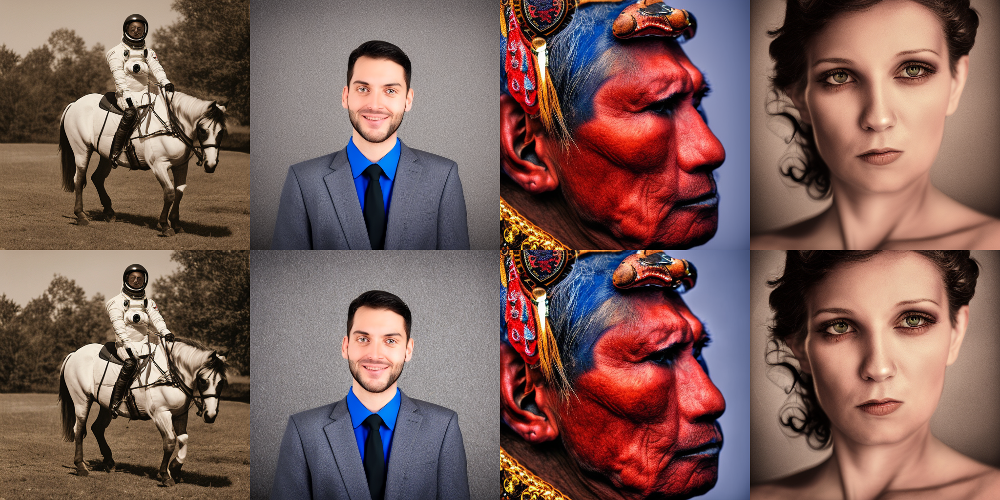

In [22]:
image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
           + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

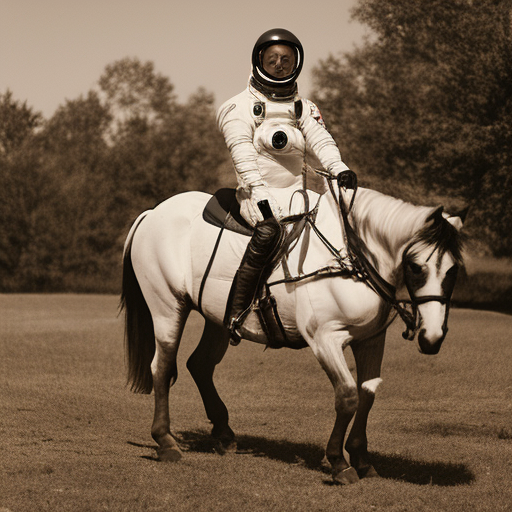

In [56]:
ref_images[0]

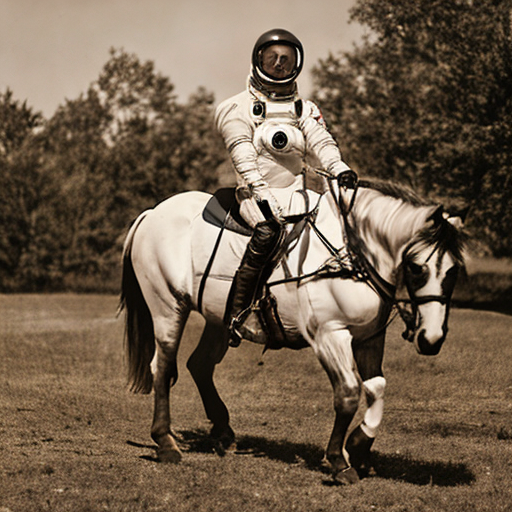

In [57]:
imgs[0]

# Log some graphs into the pipeline

In [24]:
def update_with_debug_logs(latents, i, t, text_embeddings, do_classifier_free_guidance):
    traj_pts_times.append(t)
    traj_pts_values.append(latents)

    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    new_latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    latent_step = new_latents-latents 
    steps_unit_vecs.append(latent_step/latent_step.norm()) 
    steps_magnitudes.append(latent_step.norm())
    return new_latents

In [25]:
steps_unit_vecs = []
steps_magnitudes = []
traj_pts_times = []
traj_pts_values = []

In [26]:
torch.manual_seed(seed)
imgs = my_sd_sampling(custom_update=update_with_debug_logs)

100%|██████████| 50/50 [00:54<00:00,  1.10s/it]


In [27]:
# image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
#            + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

In [28]:
dir_cosine_sim = [ (steps_unit_vecs[i+1].view(1, -1) @ steps_unit_vecs[i].view(1, -1).T).detach().cpu().numpy() 
                    for i in range(len(steps_unit_vecs)-1)]

In [29]:
dir_changes_norm = [(steps_unit_vecs[i+1] - steps_unit_vecs[i]).norm().detach().cpu().numpy() 
                    for i in range(len(steps_unit_vecs)-1)]
steps_norm = [sn.detach().cpu().numpy() for sn in steps_magnitudes]

Text(0.5, 1.0, 'Step Length')

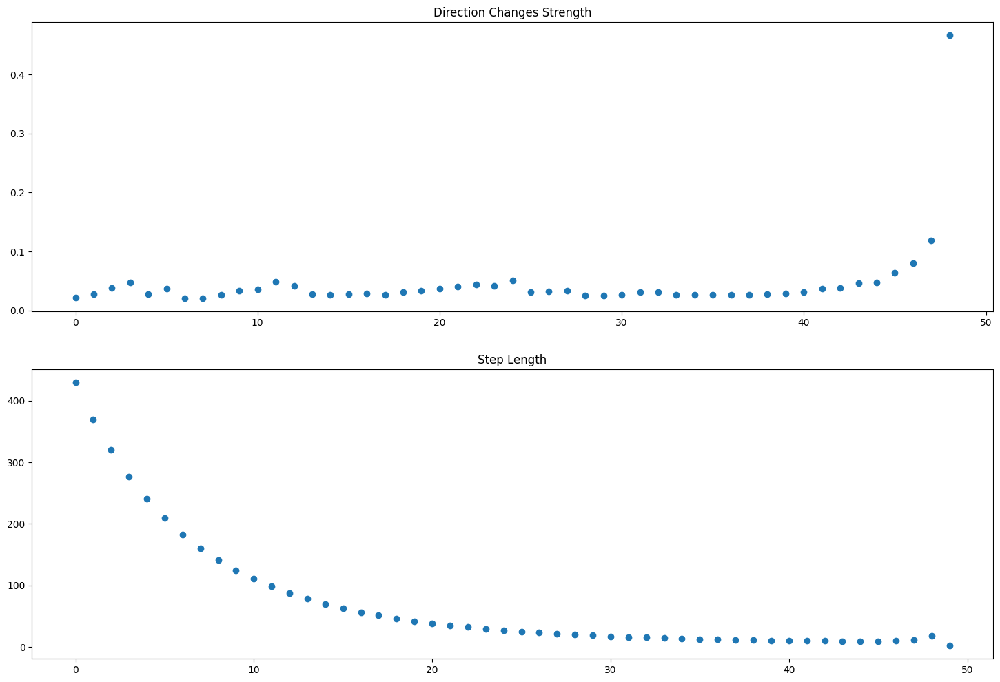

In [30]:
fig, axs = plt.subplots(2, 1, figsize=(18, 12))
axs[0].scatter(range(len(dir_changes_norm)), dir_changes_norm)
axs[0].set_title("Direction Changes Strength")
axs[1].scatter(range(len(steps_norm)), steps_norm)
axs[1].set_title("Step Length")

Note that the direction seems to be changing a lot at the end. This tends to make me think that the algorithm overshoots a bit at the end. Maybe this is something we can fix! 

# Prevent overshooting at the end

In [31]:
def update_without_overshoot(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    # compute the previous noisy sample x_t -> x_t-1
    new_latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    if i>=round(0.8*num_inference_steps) and i!=num_inference_steps-1:
        new_latents = latents + 0.85 * (new_latents-latents)
        
    latent_step = new_latents-latents 
    steps_unit_vecs.append(latent_step/latent_step.norm()) 
    steps_magnitudes.append(latent_step.norm())
    return new_latents

In [32]:
steps_unit_vecs = []
steps_magnitudes = []

In [33]:
torch.manual_seed(seed)
imgs = my_sd_sampling(custom_update=update_without_overshoot)

100%|██████████| 50/50 [00:55<00:00,  1.10s/it]


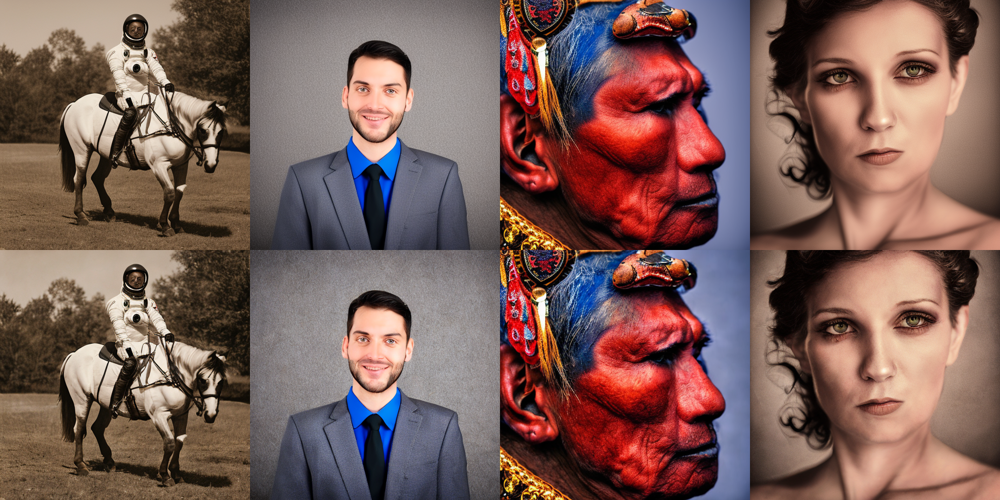

In [34]:
image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
           + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

We can do a before/after comparison for one of the images

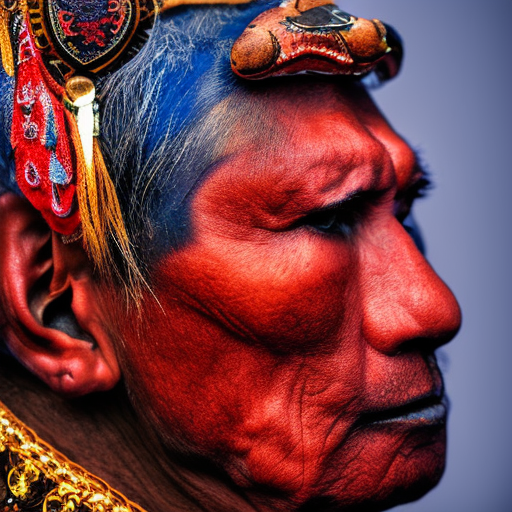

In [40]:
ref_images[-2]

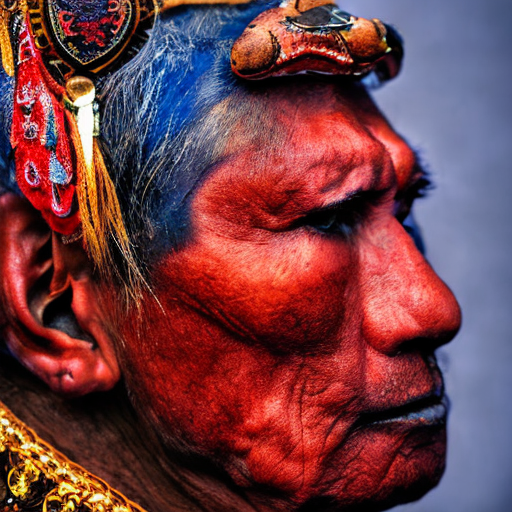

In [39]:
imgs[-2]

The images look definitely sharper!!

# Polynomial Fit of Latents

In [41]:
import numpy as np

In [42]:
def my_new_sd_sampling(prompt=prompts, device=device, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt, 
             custom_update=None):
    
    # 0. Default height and width to unet
    height = pipe.unet.config.sample_size * pipe.vae_scale_factor
    width = pipe.unet.config.sample_size * pipe.vae_scale_factor

    # 1. Check inputs. Raise error if not correct
    pipe.check_inputs(prompt, height, width, callback_steps=1)

    # 2. Define call parameters
    batch_size = 1 if isinstance(prompt, str) else len(prompt)

    # here `guidance_scale` is defined analog to the guidance weight `w` of equation (2)
    # of the Imagen paper: https://arxiv.org/pdf/2205.11487.pdf . `guidance_scale = 1`
    # corresponds to doing no classifier free guidance.
    do_classifier_free_guidance = guidance_scale > 1.0

    # 3. Encode input prompt
    text_embeddings = pipe._encode_prompt(prompt, device, num_images_per_prompt, 
                                          do_classifier_free_guidance, negative_prompt=None)

    # 4. Prepare timesteps
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = pipe.scheduler.timesteps

    # 5. Prepare latent variables
    num_channels_latents = pipe.unet.in_channels
    latents = pipe.prepare_latents(
        batch_size * num_images_per_prompt,
        num_channels_latents,
        height,
        width,
        text_embeddings.dtype,
        device,
        generator=None,
        latents=None,
    )

    with torch.no_grad():
        
        traj_pts_times, traj_pts_values = [], []
        # 7. Denoising loop
        for i, t in enumerate(pipe.progress_bar(timesteps)):
            traj_pts_times.append(t)
            traj_pts_values.append(latents)
            if custom_update is not None:
                latents = custom_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
            else:
                latents = regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
        
        latents = compute_converged_latent(traj_pts_times, traj_pts_values)
        
        traj_pts_times, traj_pts_values = [], []
        # 8. Post-processing
        image = pipe.decode_latents(latents)

        # 9. Run safety checker
        image, has_nsfw_concept = pipe.run_safety_checker(image, device, text_embeddings.dtype)
        
        # 10. Convert to PIL
        images = pipe.numpy_to_pil(image)
    
    return images

In [43]:
def compute_converged_latent(traj_pts_times, traj_pts_values):
    bs = traj_pts_values[0].shape[0]
    pts = torch.stack([pt.flatten() for pt in traj_pts_values])
    times = torch.Tensor([t for t in traj_pts_times])
    times = 999-times
    coefficients, residuals, rank, singular_values, rcond = np.polyfit(times.float().detach().cpu().numpy()[:], 
                                                                   pts.float().detach().cpu().numpy()[:], 
                                                                   deg=6, full=True)
    y_pred = np.polyval(coefficients, 1024)
    converged_latents = torch.from_numpy(y_pred).view(bs, 4, 64, 64).half().to(device)
    return converged_latents

In [44]:
torch.manual_seed(seed)
imgs = my_new_sd_sampling()

100%|██████████| 50/50 [00:54<00:00,  1.09s/it]


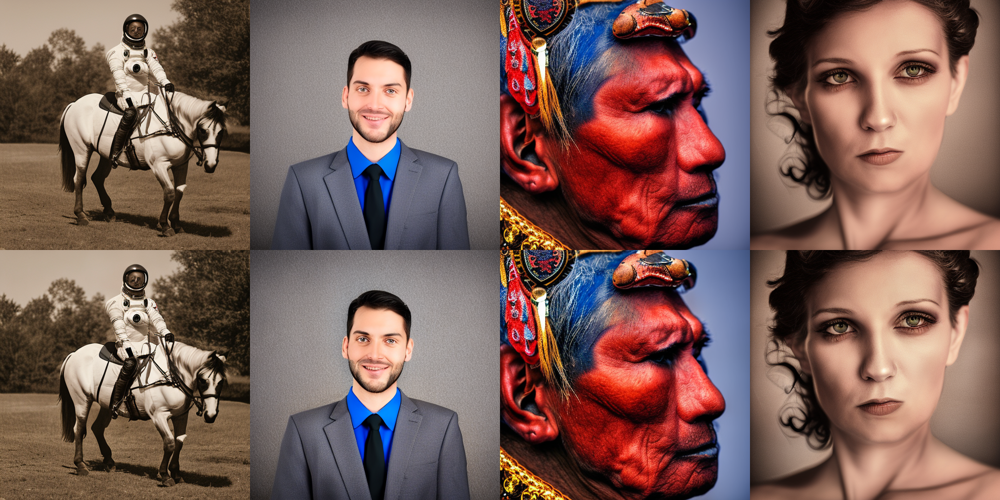

In [45]:
image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
           + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

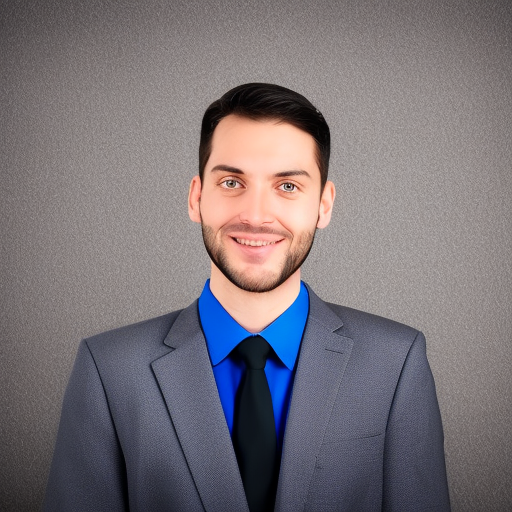

In [48]:
ref_images[1]

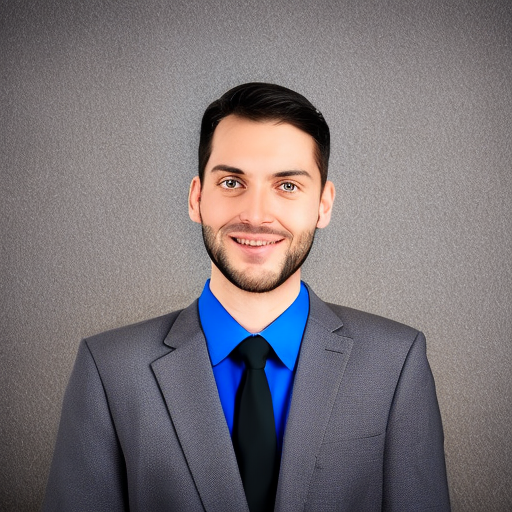

In [49]:
imgs[1]

Here again, we see that the image quality has overall improved after the trajectory smoothing

# Everything combined

In [50]:
def update_with_all_improv(latents, i, t, text_embeddings, do_classifier_free_guidance):
    # expand the latents if we are doing classifier free guidance
    latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
    latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

    # predict the noise residual
    noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

    # perform guidance
    if do_classifier_free_guidance:
        noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
        dir_change = noise_pred_text/noise_pred_text.norm() - noise_pred_uncond/noise_pred_uncond.norm()
        noise_pred = noise_pred_uncond + guidance_scale * dir_change * noise_pred_uncond.norm()
        noise_pred = noise_pred/noise_pred.norm()*noise_pred_uncond.norm()

    # compute the previous noisy sample x_t -> x_t-1
    new_latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample
    if i>=round(0.9*num_inference_steps) and i!=num_inference_steps-1:
        new_latents = latents + 0.9 * (new_latents-latents)
        
    latent_step = new_latents-latents 
    return new_latents

In [51]:
def my_new_sd_sampling(prompt=prompts, device=device, 
             guidance_scale=guidance_scale, 
             num_inference_steps=num_inference_steps, 
             num_images_per_prompt=num_images_per_prompt, 
             custom_update=None):
    
    # 0. Default height and width to unet
    height = pipe.unet.config.sample_size * pipe.vae_scale_factor
    width = pipe.unet.config.sample_size * pipe.vae_scale_factor

    # 1. Check inputs. Raise error if not correct
    pipe.check_inputs(prompt, height, width, callback_steps=1)

    # 2. Define call parameters
    batch_size = 1 if isinstance(prompt, str) else len(prompt)

    # here `guidance_scale` is defined analog to the guidance weight `w` of equation (2)
    # of the Imagen paper: https://arxiv.org/pdf/2205.11487.pdf . `guidance_scale = 1`
    # corresponds to doing no classifier free guidance.
    do_classifier_free_guidance = guidance_scale > 1.0

    # 3. Encode input prompt
    text_embeddings = pipe._encode_prompt(prompt, device, num_images_per_prompt, 
                                          do_classifier_free_guidance, negative_prompt=None)

    # 4. Prepare timesteps
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = pipe.scheduler.timesteps

    # 5. Prepare latent variables
    num_channels_latents = pipe.unet.in_channels
    latents = pipe.prepare_latents(
        batch_size * num_images_per_prompt,
        num_channels_latents,
        height,
        width,
        text_embeddings.dtype,
        device,
        generator=None,
        latents=None,
    )

    with torch.no_grad():
        
        traj_pts_times, traj_pts_values = [], []
        # 7. Denoising loop
        for i, t in enumerate(pipe.progress_bar(timesteps)):
            traj_pts_times.append(t)
            traj_pts_values.append(latents)
            if custom_update is not None:
                latents = custom_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
            else:
                latents = regular_update(latents, i, t, text_embeddings, do_classifier_free_guidance)
        
        latents = compute_converged_latent(traj_pts_times, traj_pts_values)
        
        traj_pts_times, traj_pts_values = [], []
        # 8. Post-processing
        image = pipe.decode_latents(latents)

        # 9. Run safety checker
        image, has_nsfw_concept = pipe.run_safety_checker(image, device, text_embeddings.dtype)
        
        # 10. Convert to PIL
        images = pipe.numpy_to_pil(image)
    
    return images

In [52]:
torch.manual_seed(seed)
imgs = my_new_sd_sampling(custom_update=update_with_all_improv)

100%|██████████| 50/50 [00:54<00:00,  1.09s/it]


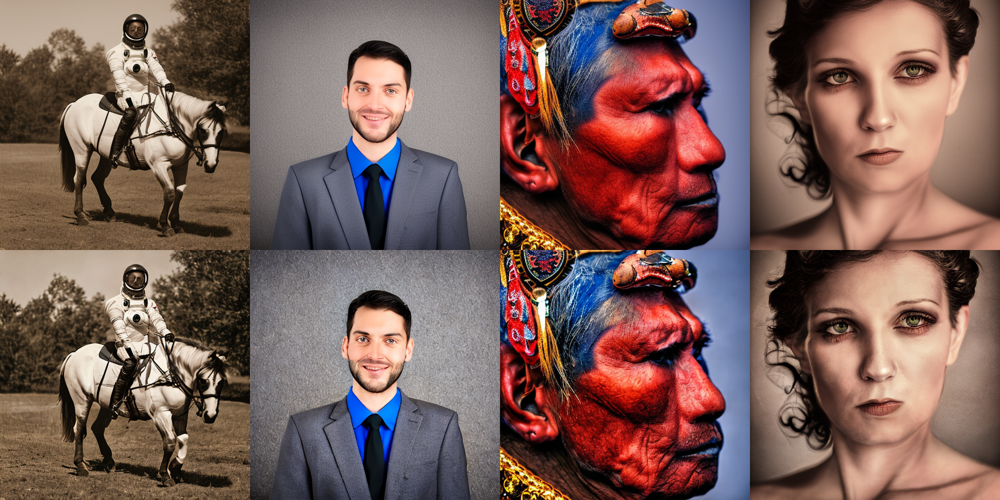

In [53]:
image_grid(ref_images[:len(prompts)] + imgs[:len(prompts)] 
           + ref_images[len(prompts):] + imgs[len(prompts):], rows=2*num_images_per_prompt, cols=len(prompts))

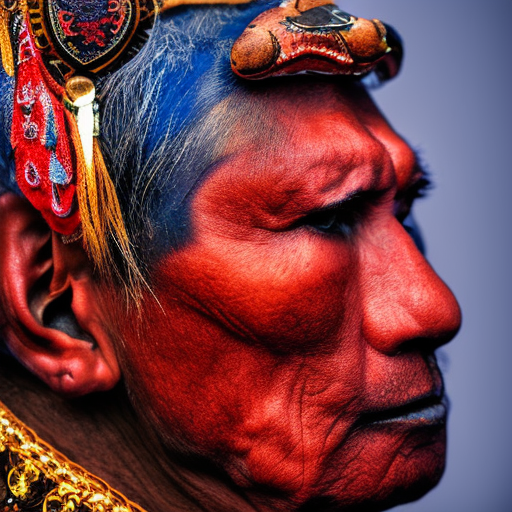

In [58]:
ref_images[-2]

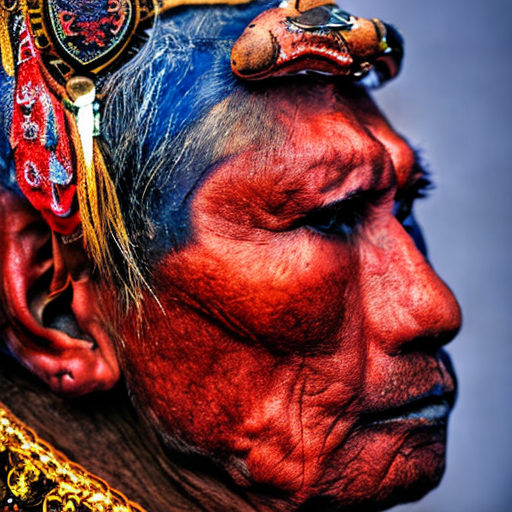

In [59]:
imgs[-2]

Overall, we made 3 modifications: 
- rescale during the guidance weighted average 
- preventing the overshoot at the end
- smoothing the sampling trajectory using polynomial fit 

Each of those modifications seems to give better results independently, making the images sharper and more realistic (less "catalogue") in my opinion. When combined together though, they may make the images TOO MUCH sharper, which can be a bad thing, depending on the effect one wants to get at the end. At the end of the day, I think these changes can be helpful as additional controls to how SD performs.